In [1]:
using DriftDiffusionModels
using Plots
using StatsBase

In [2]:
# create a DDM we will sample RT and choices from
B = 6.0
v = 0.23
α₀ = 0.5 # fixed
τ = 0.21
σ = 1.0 # fixed

ddm = DriftDiffusionModel(B, v, α₀, τ, σ)

# now we sample
data = simulateDDM(ddm, 10000, 1e-6);

In [5]:
data[1].rt

4.572976000285297

In [8]:
@profview DriftDiffusionModels.wfpt(data[1].rt, 0.23, 6.0, 0.5, 0.21, 1e-6)

┌ Warning: There were no samples collected.
│ Run your program longer (perhaps by running it multiple times),
│ or adjust the delay between samples with `Profile.init()`.
└ @ Profile C:\Users\ryansenne\.julia\juliaup\julia-1.10.4+0.x64.w64.mingw32\share\julia\stdlib\v1.10\Profile\src\Profile.jl:1214


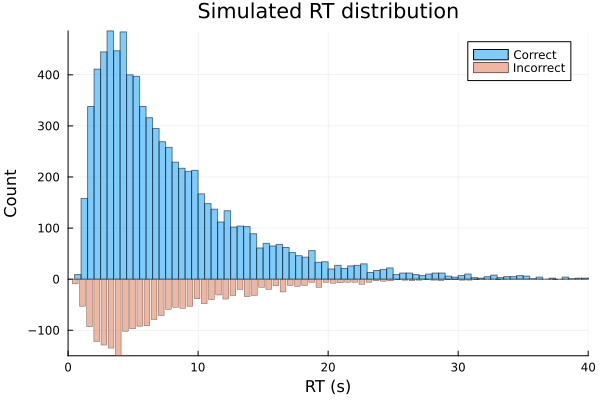

In [3]:
correct_trials = [x for x in data if x.choice == 1]
incorrect_trials = [x for x in data if x.choice == -1];

rt_dist_plot = histogram([x.rt for x in correct_trials], bins=100, alpha=0.5, label="Correct", legend=:topright)
incorrect_rts = [x.rt for x in incorrect_trials]
h = fit(Histogram, incorrect_rts, range(0, maximum(incorrect_rts), length=101))
bar!(h.edges[1][1:end-1], -h.weights, width=step(h.edges[1]), 
     alpha=0.5, 
     label="Incorrect")
# Adjust y-axis to make room for the downward bars
xlabel!("RT (s)")
ylabel!("Count")
title!("Simulated RT distribution")
# ylims!(minimum([-h.weights; 0]) * 1.1, maximum(h.weights) * )
xlims!(0, 40)

In [4]:
# using the data from generated above, fit the DDM. Here we assume a single state model so no weights necessary.
naive_ddm = DriftDiffusionModel(7., 0.5, 0.5, 0.1, 1.)
fit!(naive_ddm, data)

DriftDiffusionModel(5.980401784891672, 0.233240870221971, 0.5, 0.2265205297837359, 1.0)

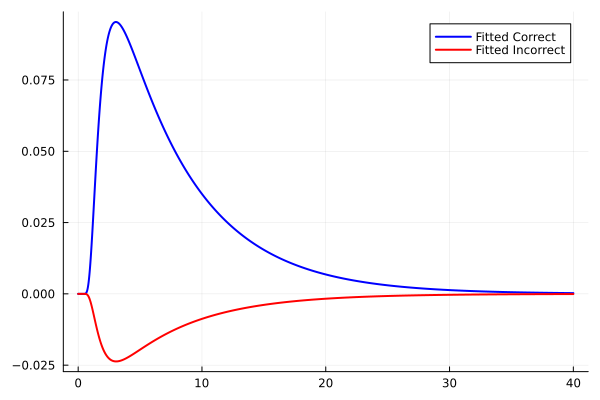

In [5]:
# plot the fittted DDM onto the prior Plot
ddm_times = 0:0.0001:40
ddm_correct_pdf = [wfpt(t, -naive_ddm.v, naive_ddm.B, 1 - naive_ddm.a₀, naive_ddm.τ) for t in ddm_times]
ddm_incorrect =    [wfpt(t, naive_ddm.v, naive_ddm.B, naive_ddm.a₀, naive_ddm.τ) for t in ddm_times]

plot(ddm_times, ddm_correct_pdf, label="Fitted Correct", color=:blue, lw=2)
plot!(ddm_times, -ddm_incorrect, label="Fitted Incorrect", color=:red, lw=2)